In [2]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import glob
%matplotlib inline

In [1]:
from main import abs_sobel_thresh, mag_thresh, dir_thresh_abs, dir_thresh, hls_thresh, find_curvatures

## Camera distortion calibration

In [3]:
# Camera distortion calibration
from Calibration import Calibration
myCal = Calibration(width=9, hgt=6)
myCal.set_img_location('camera_cal', 'calibration*.jpg')
myCal.calibrate()

20 image files to process...
Distortion calibration complete. 17 images used


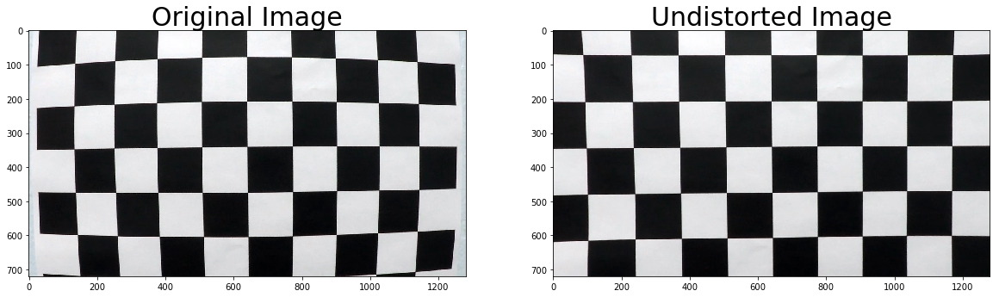

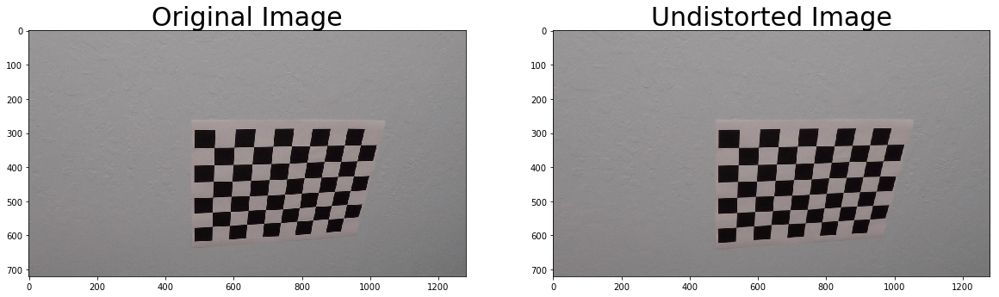

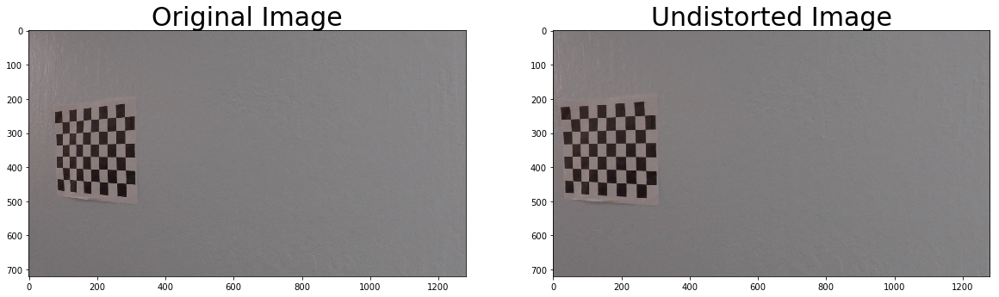

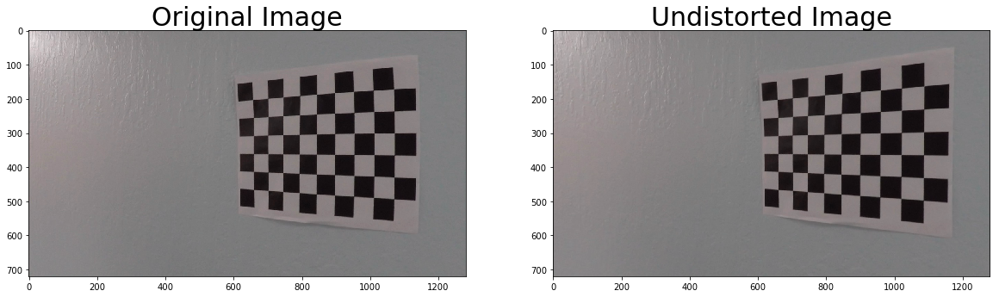

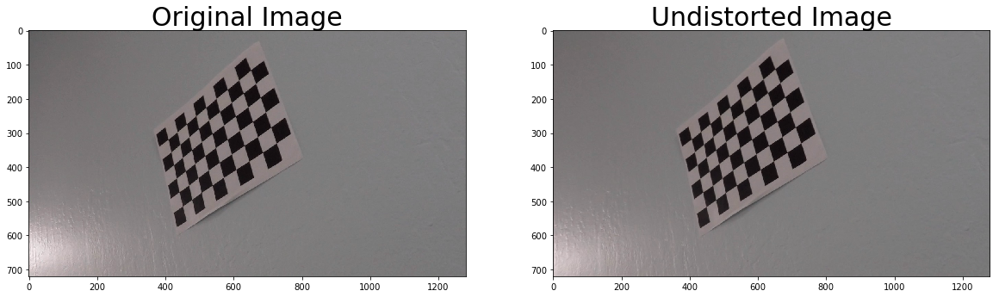

...

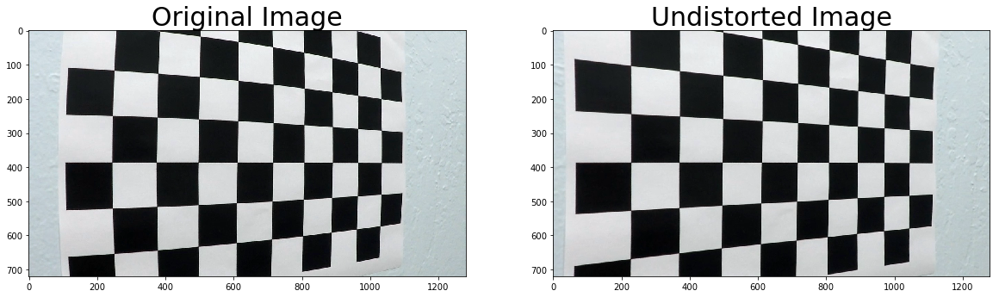

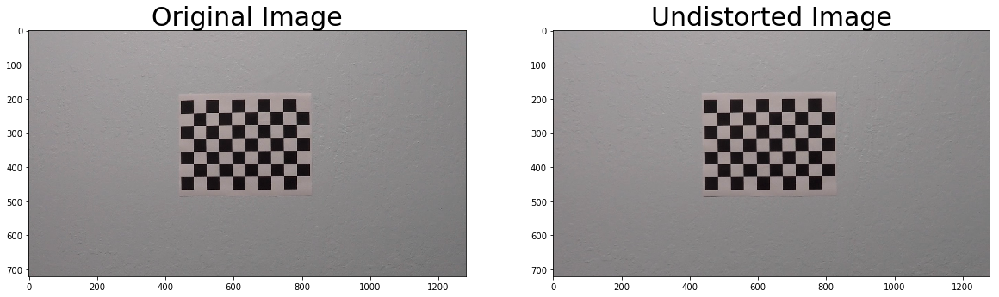

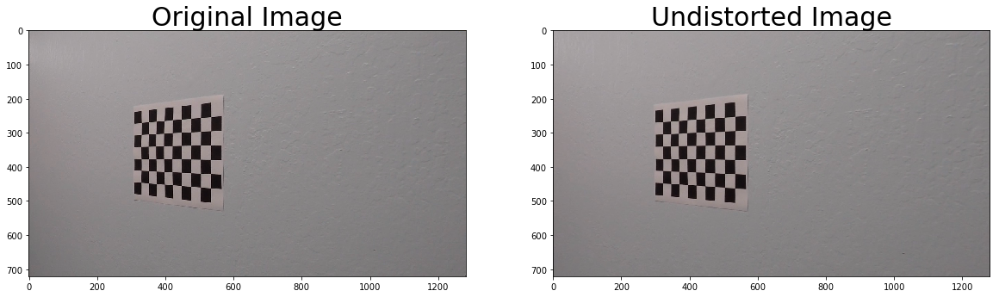

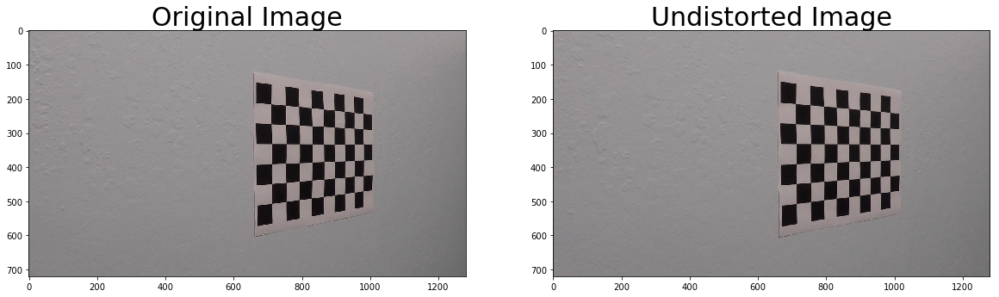

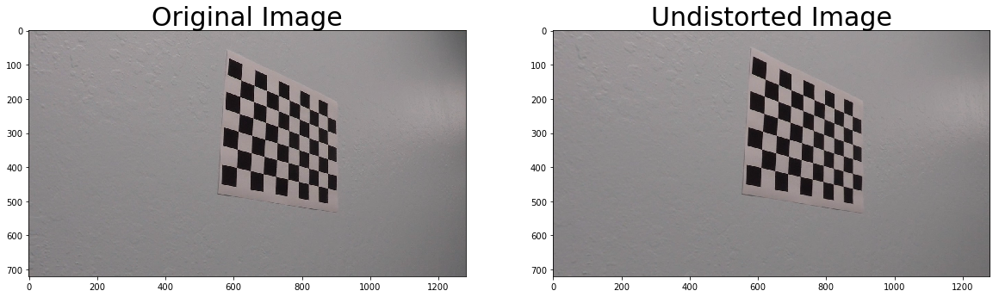

In [4]:
# load calibration images
cal_images = glob.glob('camera_cal/calibration*.jpg')

# run each image thru calibration and plot
for fname in cal_images:
    img = cv2.imread(fname)
    dst = myCal.apply(img)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(dst)
    ax2.set_title('Undistorted Image', fontsize=30)
    plt.show()

## Perspective Transform

In [5]:
# Perspective transform
from PerspectiveTransform import PerspectiveTransform
myXform = PerspectiveTransform()
# set 4 arbitrary pts for the transform
src = np.float32([[585,460],[203,720],[1127,720],[695,460]])
dst = np.float32([[320,0],[320,720],[960,720],[960,0]])
myXform.set_src(src)
myXform.set_dst(dst)
myXform.calibrate()

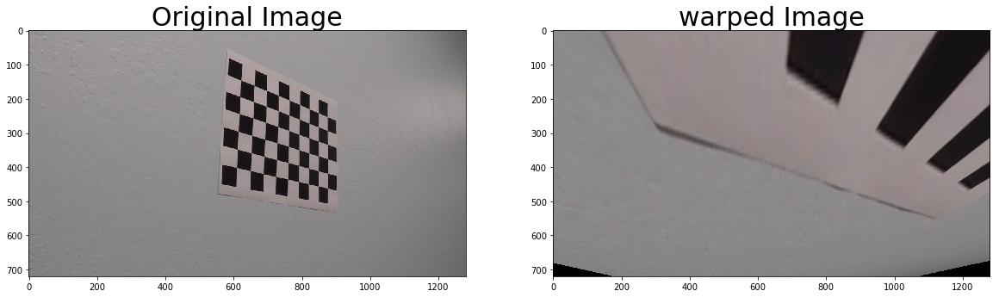

In [6]:
# take img (last) and transform it
warp = myXform.transform(img)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(warp)
ax2.set_title('warped Image', fontsize=30)
plt.show()

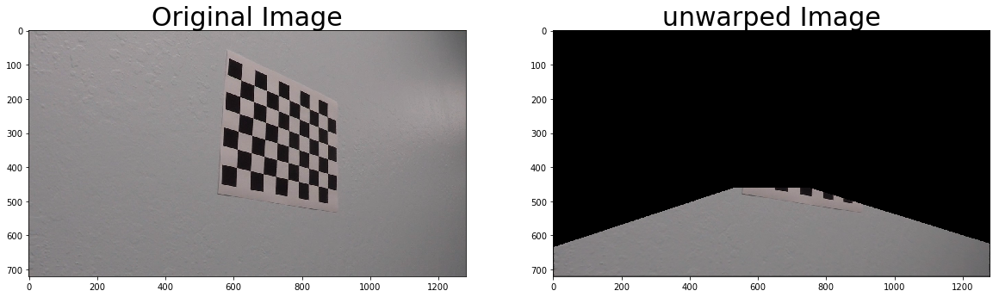

In [7]:
# inverse transform it. should get back orig img (portion of it)
unwarp = myXform.inv_transform(warp)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(unwarp)
ax2.set_title('unwarped Image', fontsize=30)
plt.show()

In [8]:
# load road test images into a list (of images)
test_fnames = glob.glob('test_images/test*.jpg')
test_images = []
for fname in test_fnames:
    test_images.append(cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB)) # immediately convert to RGB!

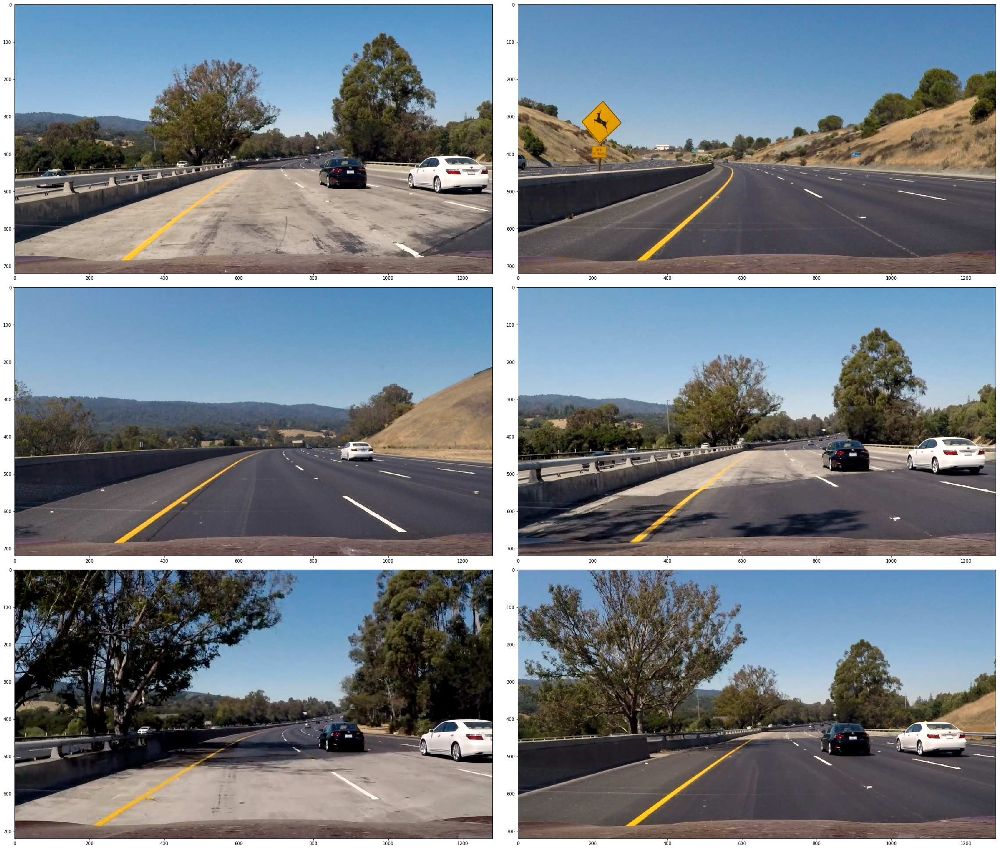

In [9]:
# plot out orig images
f, ax = plt.subplots(3, 2, figsize=(32,27))
ax = ax.flatten()
f.tight_layout()
# run each image thru calibration and plot
for idx, img in enumerate(test_images):
    ax[idx].imshow(img)
plt.show()

In [10]:
# create gray scale imgs
gray_imgs = [cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) for img in test_images]

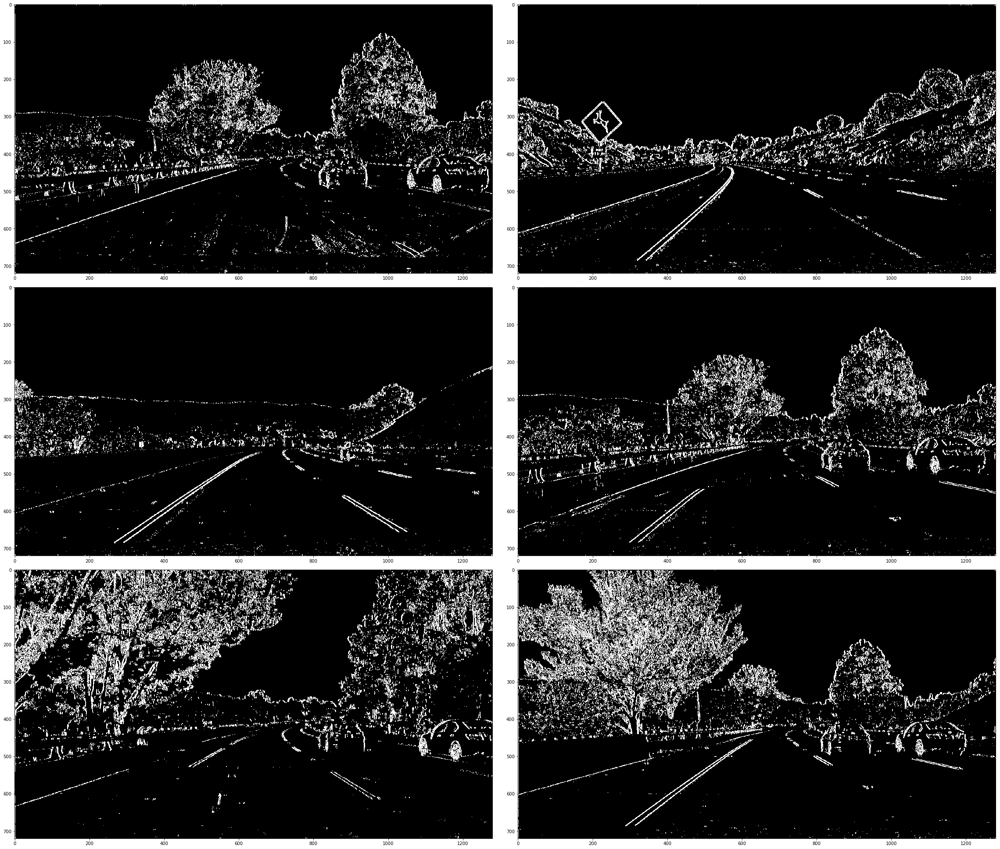

In [11]:
# X-sobel threshold
f, ax = plt.subplots(3, 2, figsize=(32,27))
ax = ax.flatten()
f.tight_layout()
# run each image thru calibration and plot
for idx, gray in enumerate(gray_imgs):
    img = abs_sobel_thresh(gray, orient='x', sobel_kernel=3, thresh=(20,200))
    ax[idx].imshow(img, cmap='gray')
plt.show()

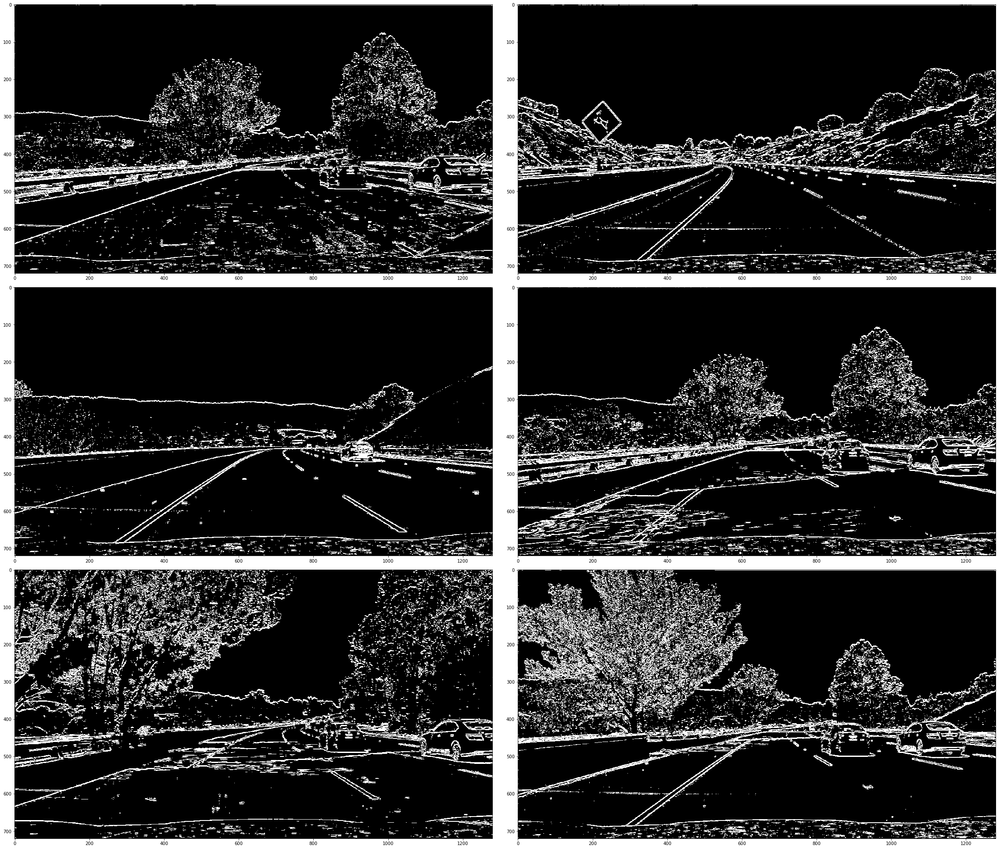

In [12]:
# Y-sobel threshold
f, ax = plt.subplots(3, 2, figsize=(32,27))
ax = ax.flatten()
f.tight_layout()
# run each image thru calibration and plot
for idx, gray in enumerate(gray_imgs):
    img = abs_sobel_thresh(gray, orient='y', sobel_kernel=3, thresh=(20,200))
    ax[idx].imshow(img, cmap='gray')
plt.show()

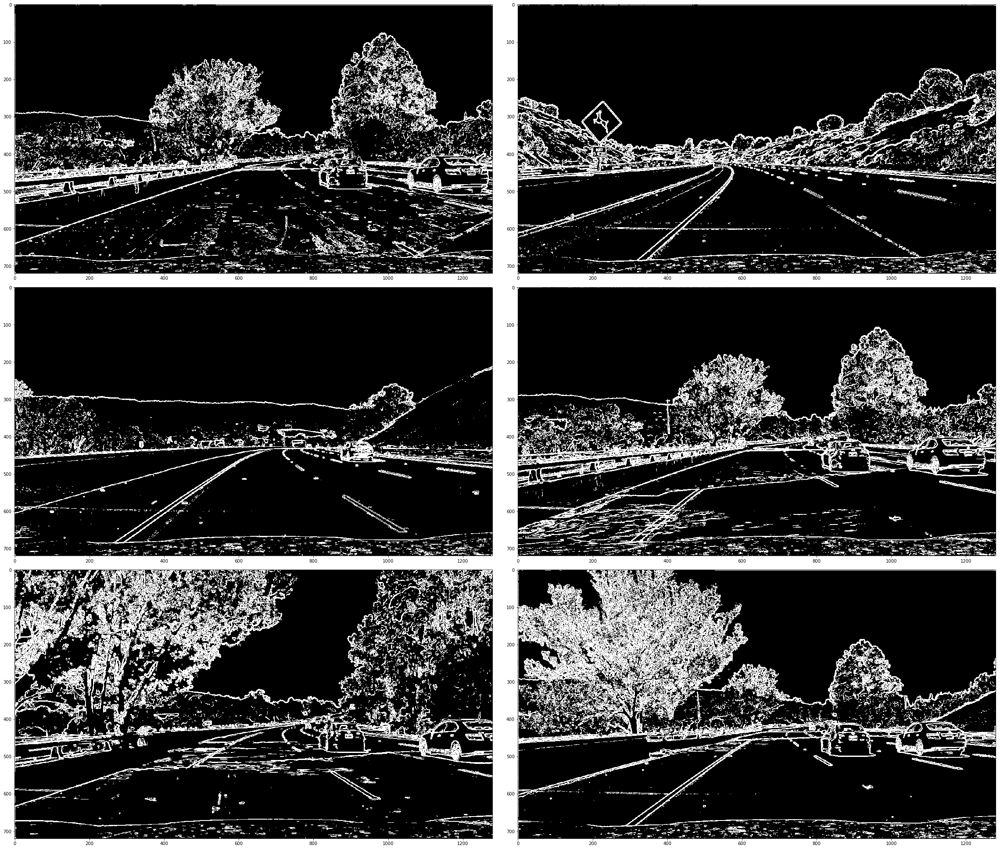

In [13]:
# MAG-sobel threshold
f, ax = plt.subplots(3, 2, figsize=(32,27))
ax = ax.flatten()
f.tight_layout()
# run each image thru calibration and plot
for idx, gray in enumerate(gray_imgs):
    img = mag_thresh(gray, sobel_kernel=3, thresh=(20,200))
    ax[idx].imshow(img, cmap='gray')
plt.show()

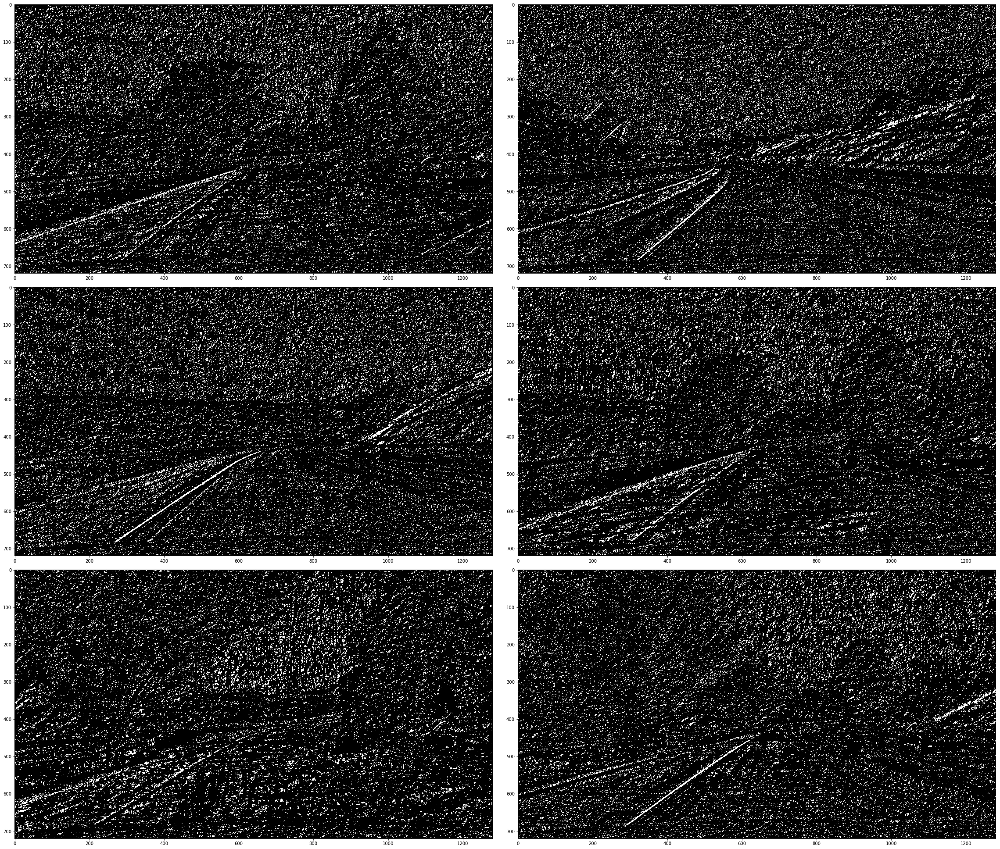

In [14]:
# DIR-sobel threshold
f, ax = plt.subplots(3, 2, figsize=(32,27))
ax = ax.flatten()
f.tight_layout()
# run each image thru calibration and plot
for idx, gray in enumerate(gray_imgs):
    img = dir_thresh(gray, sobel_kernel=3, thresh=(40*np.pi/180,75*np.pi/180))
    ax[idx].imshow(img, cmap='gray')
plt.show()

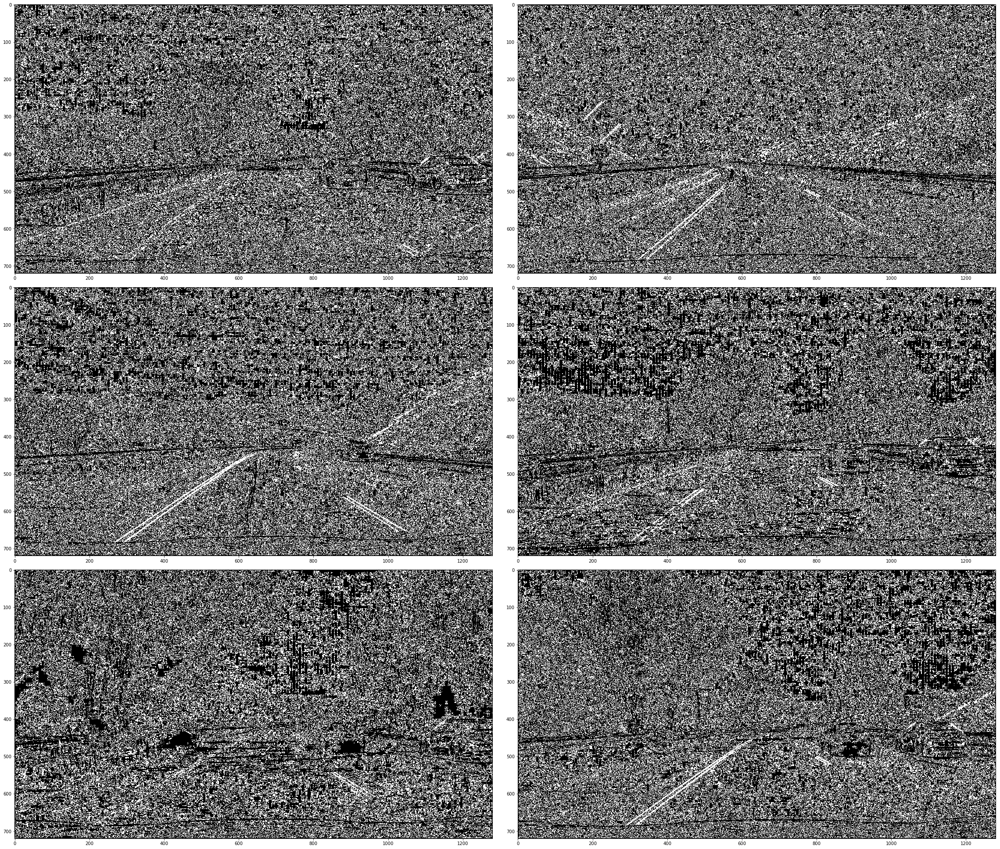

In [15]:
# ABS DIR-sobel threshold
f, ax = plt.subplots(3, 2, figsize=(32,27))
ax = ax.flatten()
f.tight_layout()
# run each image thru calibration and plot
for idx, gray in enumerate(gray_imgs):
    img = dir_thresh_abs(gray, sobel_kernel=3, thresh=(40*np.pi/180,75*np.pi/180))
    ax[idx].imshow(img, cmap='gray')
plt.show()

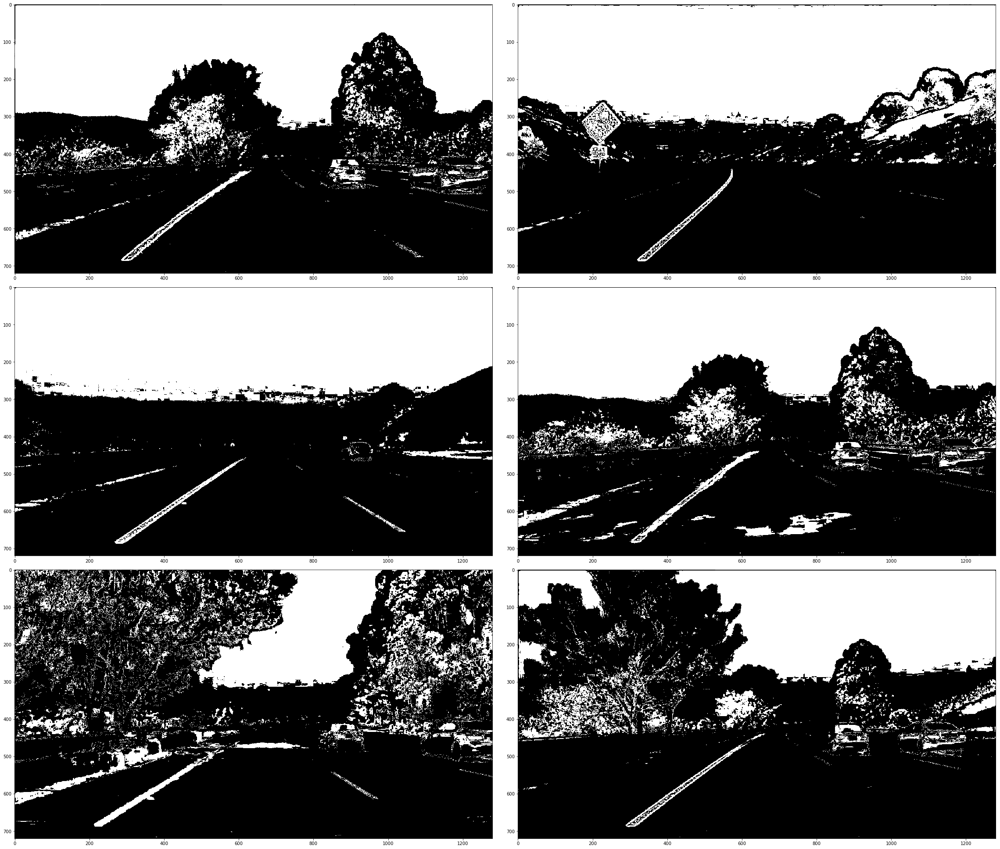

In [16]:
# HLS threshold
f, ax = plt.subplots(3, 2, figsize=(32,27))
ax = ax.flatten()
f.tight_layout()
# run each image thru calibration and plot
for idx, img in enumerate(test_images):
    img = hls_thresh(img, ch_sel='s', thresh=(90,255))
    ax[idx].imshow(img, cmap='gray')
plt.show()

## Straight Line to extract corners for perspective transform

In [17]:
# load STRAIGHT road test images into a list (of images)
straight_fnames = glob.glob('test_images/straight_lines*.jpg')
straight_images = []
for fname in straight_fnames:
    straight_images.append(cv2.cvtColor(cv2.imread(fname), cv2.COLOR_BGR2RGB)) # immediately convert to RGB!

In [18]:
gray_straight_imgs = [cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) for img in straight_images]

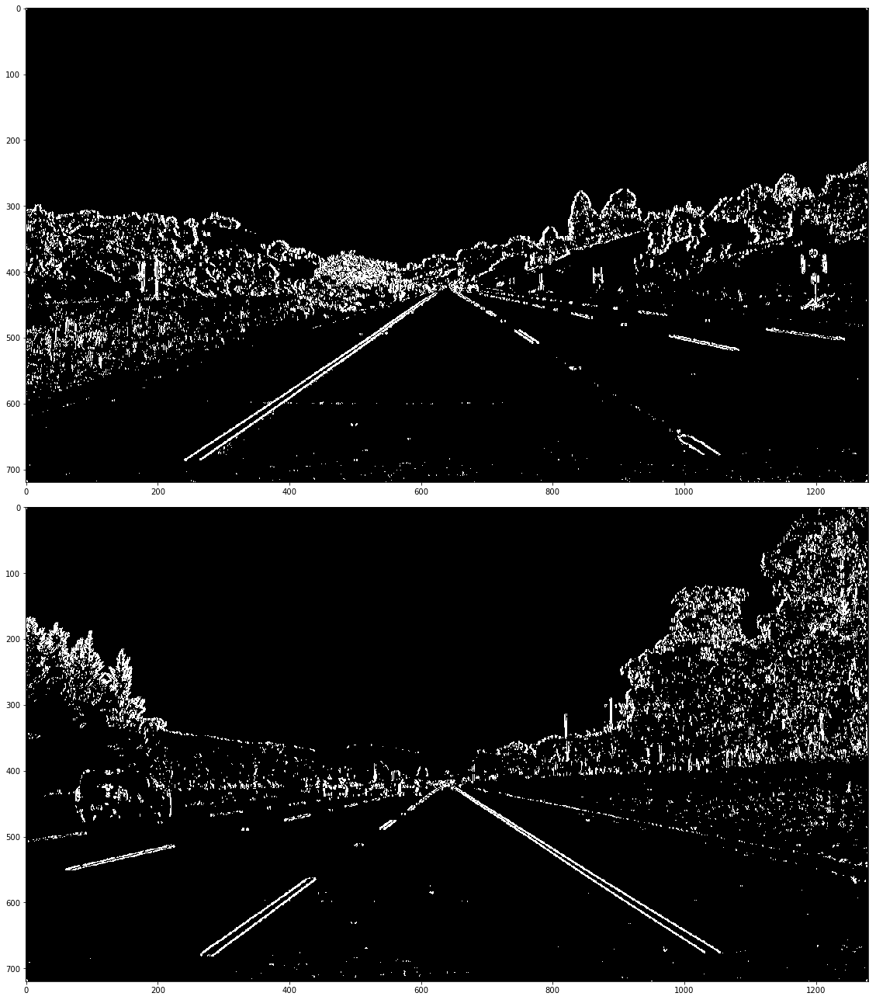

In [19]:
# X-sobel threshold
f, ax = plt.subplots(2, 1, figsize=(16,18))
ax = ax.flatten()
f.tight_layout()
# run each image thru calibration and plot
for idx, gray in enumerate(gray_straight_imgs):
    img = abs_sobel_thresh(gray, orient='x', sobel_kernel=3, thresh=(20,200))
    ax[idx].imshow(img, cmap='gray')
plt.show()

## Perspective Transform Implementation

Determine the source & destination polygons

In [20]:
# manually draw source polygon...

xl = np.array([280, 440])
yl = np.array([680, 563])

xc = 640+10
xr = np.array([1035, 860])

xpoly = np.concatenate((xl, xr[::-1]))
ypoly = np.concatenate((yl, yl[::-1]))

In [21]:
print('src X = ', xpoly)
print('src Y = ', ypoly)

src X =  [ 280  440  860 1035]
src Y =  [680 563 563 680]


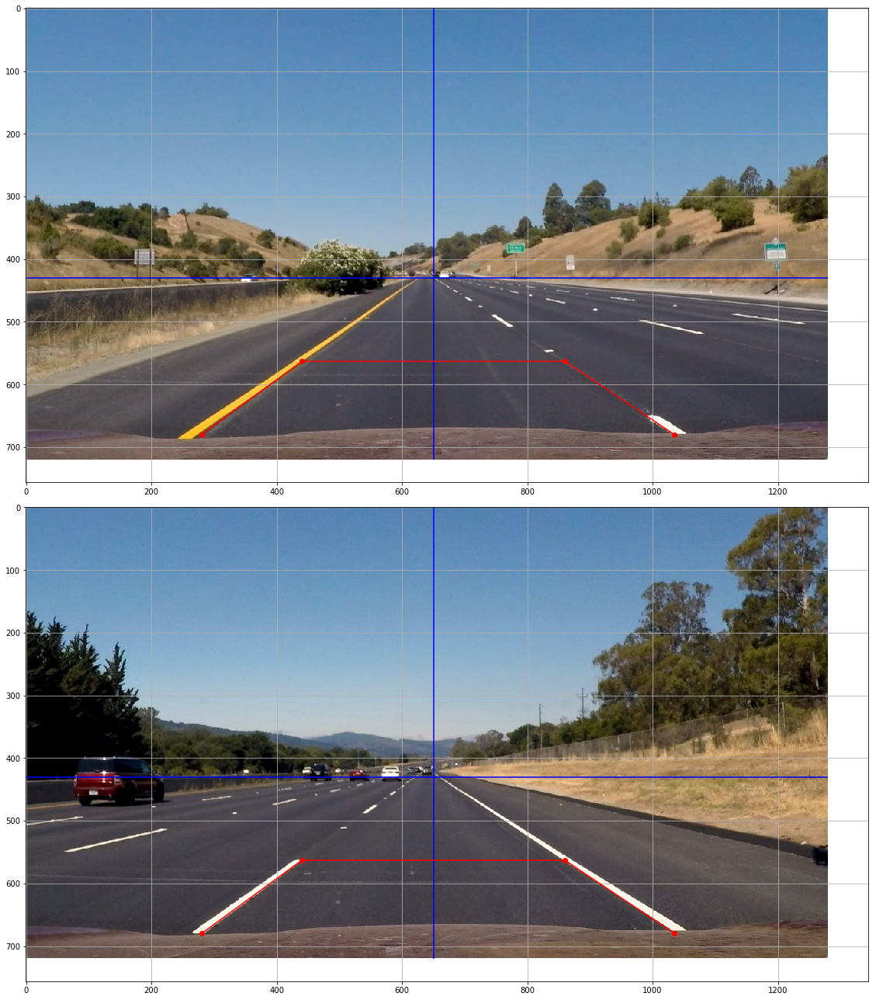

In [22]:
# draw polygon on image

f, ax = plt.subplots(2, 1, figsize=(16,18))
ax = ax.flatten()
f.tight_layout()

ax[0].imshow(straight_images[0])
ax[0].vlines(xc,0,720,'b')
ax[0].hlines(430,0,1280,'b')
ax[0].plot(xpoly,ypoly,'ro-')
ax[0].grid(True)

ax[1].imshow(straight_images[1])
ax[1].vlines(xc,0,720,'b')
ax[1].hlines(430,0,1280,'b')
ax[1].plot(xpoly,ypoly,'ro-')
ax[1].grid(True)

plt.show()

In [31]:
#set src coordinates
src_x = xpoly
src_y = ypoly
src_road = np.stack((src_x, src_y), axis=0).T.astype(np.float32)
print(src_road)

[[  280.   680.]
 [  440.   563.]
 [  860.   563.]
 [ 1035.   680.]]


In [24]:
# Now let's determine what the destination coordinate for these area are...
# Note: ASSUME this boxed distance to be:
# - 12 ft wide (min lane width)
# - 10ft long (dashed lane line length)
# Per US Regulations

dst_x = [1280*0.25, 1280*0.25, 1280*0.75, 1280*0.75]
dst_y = [720, 600, 600, 720]
dst_road = np.stack((dst_x, dst_y), axis=0).T.astype(np.float32)
print(dst_road)

[[ 320.  720.]
 [ 320.  600.]
 [ 960.  600.]
 [ 960.  720.]]


In [25]:
# Reuse the myXform instance from above
myXform.set_src(src_road)
myXform.set_dst(dst_road)
myXform.calibrate()

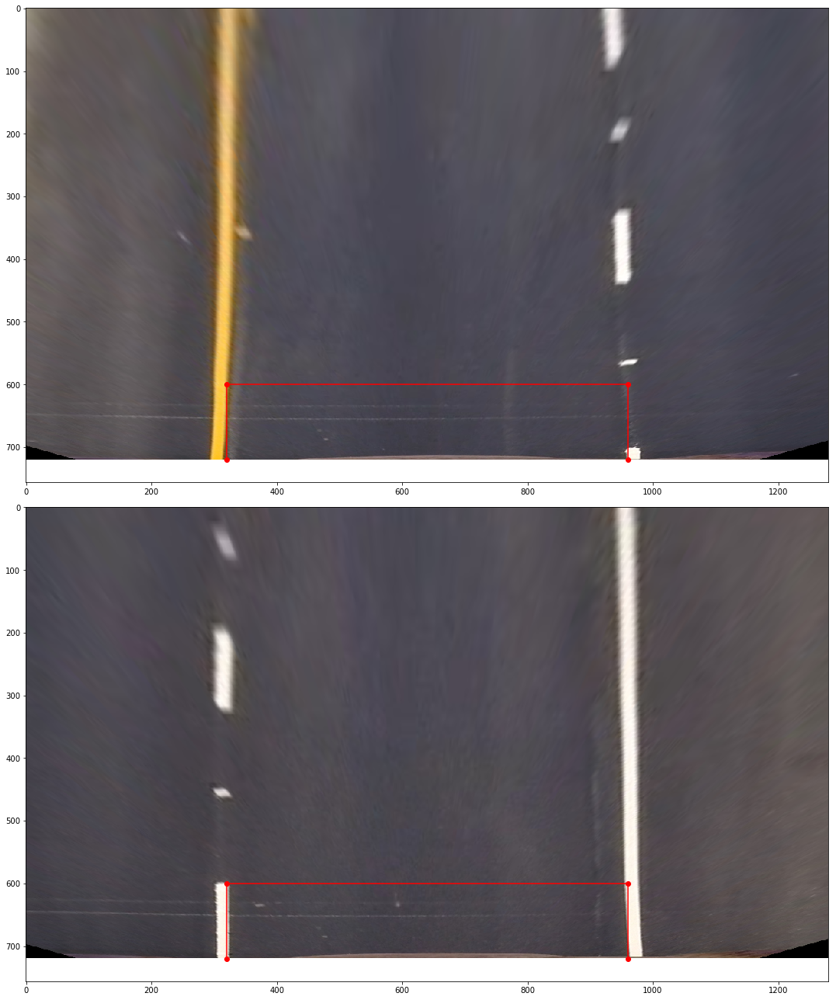

In [26]:
# birds eye view
f, ax = plt.subplots(2, 1, figsize=(16,18))
ax = ax.flatten()
f.tight_layout()

images_bird = []
# run each image thru calibration and plot
for idx, img in enumerate(straight_images):
    images_bird.append(myXform.transform(img))
    ax[idx].imshow(images_bird[idx])
    ax[idx].plot(dst_x, dst_y,'ro-')
plt.show()

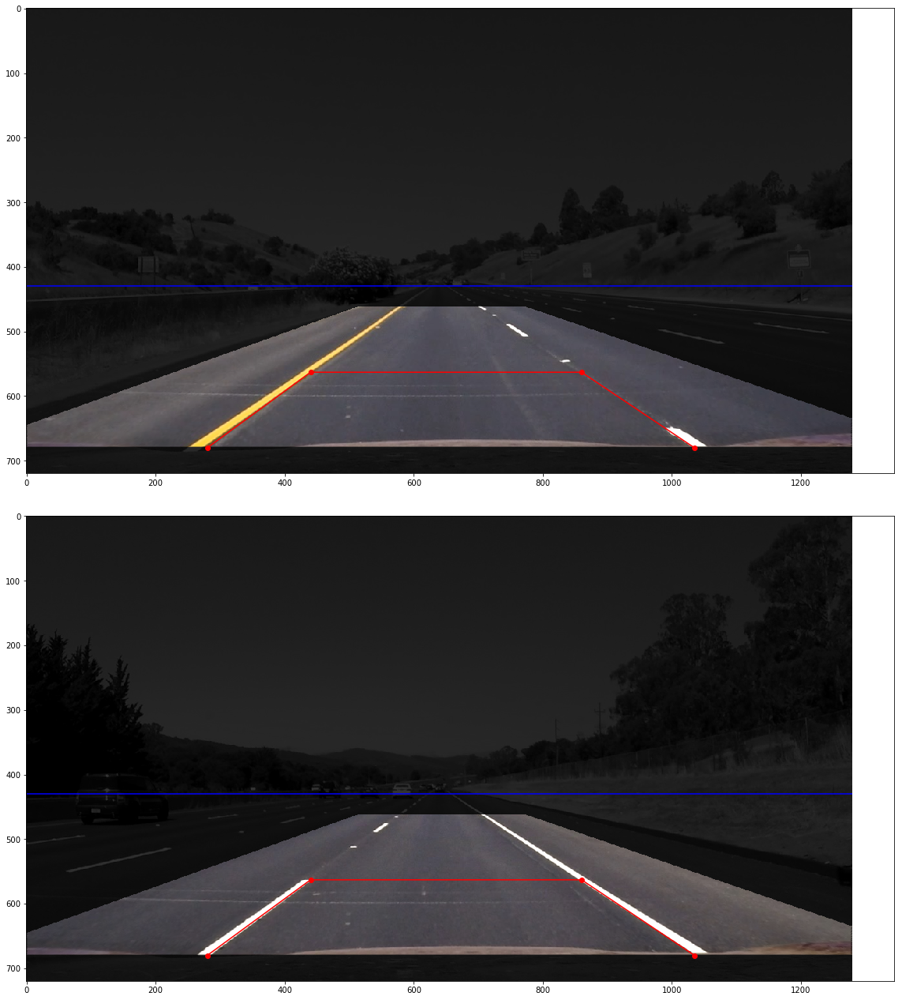

In [27]:
# transform from bird's eye back to normal view
f, ax = plt.subplots(2, 1, figsize=(16,18))
ax = ax.flatten()
f.tight_layout()

# run each image thru calibration and plot
for idx, img in enumerate(images_bird):
    img_reconstruct = cv2.addWeighted(myXform.inv_transform(img), 0.9,
                                      cv2.cvtColor(gray_straight_imgs[idx], cv2.COLOR_GRAY2RGB), 0.2, 0.0)
    ax[idx].imshow(img_reconstruct)
    ax[idx].plot(src_x, src_y,'ro-')
    ax[idx].hlines(430,0,1280,'b')
plt.show()

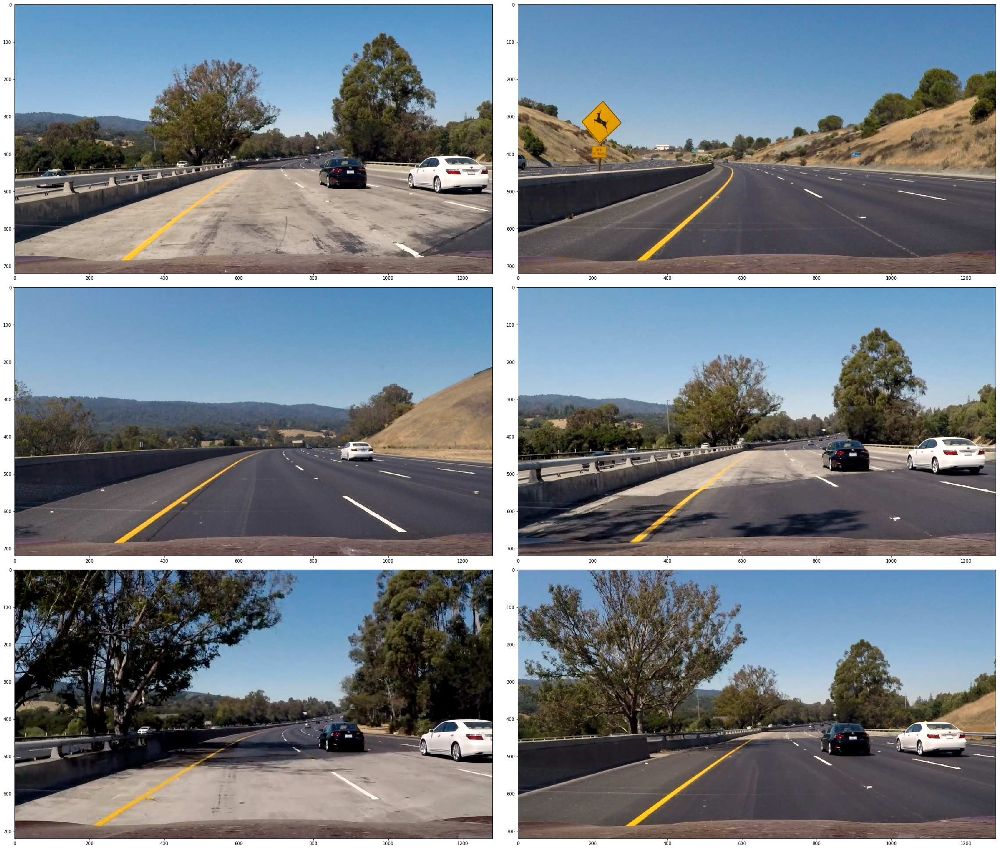

In [28]:
# plot out orig images
f, ax = plt.subplots(3, 2, figsize=(32,27))
ax = ax.flatten()
f.tight_layout()
# run each image thru calibration and plot
for idx, img in enumerate(test_images):
    ax[idx].imshow(img)
plt.show()

dst_border =
[[[    0.   720.]
  [    0.     0.]
  [ 1280.     0.]
  [ 1280.   720.]
  [    0.   720.]]]
src_border =
[[[  -97.5          680.        ]
  [  513.02471924   461.8888855 ]
  [  774.0123291    461.8888855 ]
  [ 1412.5          680.        ]
  [  -97.5          680.        ]]]


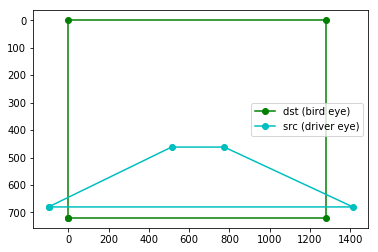

In [29]:
# Setup image border
img_size = images_bird[0].shape[0:2][::-1]
xmax, ymax = img_size
dst_border = np.float32([[[0,ymax],[0,0],[xmax,0],[xmax,ymax],[0,ymax]]])

src_border = myXform.inv_transform_pts(dst_border)

print('dst_border =')
print(dst_border)
print('src_border =')
print(src_border)

plt.plot(dst_border[0,:,0], dst_border[0,:,1], 'go-',
         src_border[0,:,0], src_border[0,:,1], 'co-')
plt.gca().invert_yaxis()
plt.legend(['dst (bird eye)', 'src (driver eye)'])
plt.show()


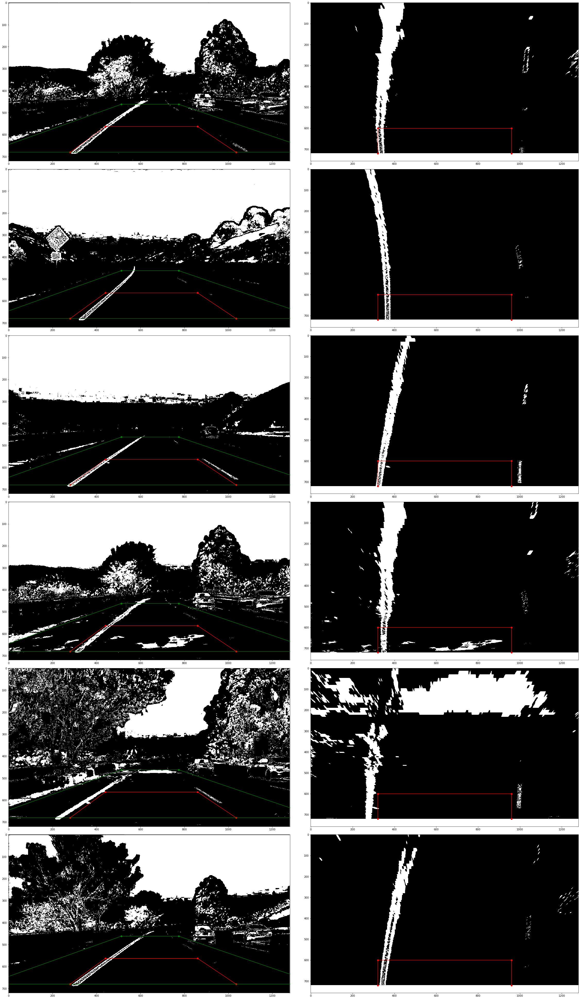

In [30]:
# plot out orig images
f, ax = plt.subplots(6, 2, figsize=(32,54))
ax = ax.flatten()
f.tight_layout()
# run each image thru calibration and plot
for idx, img in enumerate(test_images):
    img_hls = hls_thresh(img, ch_sel='s', thresh=(90,255))
    img_bird = myXform.transform(img_hls)
    img_orig = myXform.inv_transform(img_bird)
#     img_combo = cv2.addWeighted(img_orig, 0.9, gray_imgs[idx], 0.3, 0.0)
#     img_combo = cv2.addWeighted(img_orig, 0.9, gray_imgs[idx], 0.05, 0.0)

    # Left img (driver eye)
    ax[2*idx].imshow(img_hls, cmap='gray')
    ax[2*idx].plot(src_x, src_y,'ro-')
    ax[2*idx].plot(src_border[0,:,0], src_border[0,:,1], 'go-')
    ax[2*idx].set_xlim(0,gray_imgs[idx].shape[1])
    # Right img (birds eye)
    ax[2*idx+1].imshow(img_bird, cmap='gray')
    ax[2*idx+1].plot(dst_x, dst_y,'ro-')

plt.show()